In [1]:
%load_ext nb_black
%load_ext autoreload
%autoreload 2
%matplotlib inline

<IPython.core.display.Javascript object>

In [2]:
import os
from pathlib import Path
import pickle

home = str(Path.home())
data_path = os.path.join(home, "GA_generation", "Data", "GA_resampled.parquet")
perp_path = os.path.join(home, "GA_generation", "Data", "Normals_sampling.parquet")

import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
import numpy as np
import pandas as pd

from traffic.core import Traffic, Flight
from traffic.data import airports
from traffic.drawing import countries
import traffic.core.geodesy as geo

t_GA_resampled = Traffic.from_file(data_path)
perpendiculars = pd.read_parquet(perp_path)
perpendiculars["angle"] = np.arctan(perpendiculars.m)

<ipython-input-2-41e8815f6da3>:10: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


<IPython.core.display.Javascript object>

# Features engineering

In [3]:
features = ["x", "y"]
X = np.stack(list(f.data[features].values.ravel() for f in t_GA_resampled))

# On veut ploter la distribution des points selon chacune des lignes;
# Il faut donc trouver pour chaque ligne un point de référence, puis calculer la distance par rapport à ce point
# Pour la référence sur chaque ligne, on prend le ooint médian en X

X_x = X[:, ::2]
X_y = X[:, 1::2]
origins = np.zeros((len(perpendiculars), 2))

# ref_x = np.array([np.median(X_x, axis=0),] * X_x.shape[0])
# ref_y = np.array(
#     [perpendiculars.m.values * ref_x[0, :] + perpendiculars.p.values,] * X_x.shape[0]
# )

ref_x = np.array([X_x[97, :],] * X_x.shape[0])
ref_y = np.array(
    [perpendiculars.m.values * ref_x[0, :] + perpendiculars.p.values,] * X_x.shape[0]
)

origins[:, 0] = ref_x[0, :]
origins[:, 1] = ref_y[0, :]

# On projette les points d'une lignes (exprimés en x,y) sur cette ligne, pour n'avoir plus qu'un scalaire (x')
# x' = cos(alpha)*(x-x_ref) + sin(alpha)*(y-y_ref)

X_along_line = np.cos(perpendiculars.angle.values) * (X_x - ref_x) + np.sin(
    perpendiculars.angle.values
) * (X_y - ref_y)

X_along_line = pd.DataFrame(X_along_line)

<IPython.core.display.Javascript object>

# GAN

## Networks

In [77]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from sklearn import preprocessing

scale = preprocessing.MinMaxScaler().fit(X_along_line)
scale = preprocessing.StandardScaler().fit(X_along_line)
X_scaled = scale.transform(X_along_line)

data_loader = torch.utils.data.DataLoader(X_scaled, batch_size=16, shuffle=True)

<IPython.core.display.Javascript object>

In [31]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """

    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 40
        n_out = 1

        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 128), nn.LeakyReLU(0.2), nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(128, 64), nn.LeakyReLU(0.2), nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(64, 32), nn.LeakyReLU(0.2), nn.Dropout(0.3)
        )
        self.out = nn.Sequential(torch.nn.Linear(32, n_out), torch.nn.Sigmoid())

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

<IPython.core.display.Javascript object>

In [32]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """

    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 40

        self.hidden0 = nn.Sequential(nn.Linear(n_features, 256), nn.LeakyReLU(0.2))
        self.hidden1 = nn.Sequential(nn.Linear(256, 512), nn.LeakyReLU(0.2))
        self.hidden2 = nn.Sequential(nn.Linear(512, 1024), nn.LeakyReLU(0.2))

        self.out = nn.Sequential(nn.Linear(1024, n_out), nn.Tanh())

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x


# Noise
def noise(size):
    n = Variable(torch.randn(size, 100))
    if torch.cuda.is_available():
        return n.cuda()
    return n

<IPython.core.display.Javascript object>

In [33]:
discriminator = DiscriminatorNet()
generator = GeneratorNet()
if torch.cuda.is_available():
    print("GPU available")
    discriminator.cuda()
    generator.cuda()

<IPython.core.display.Javascript object>

## Optimizers

In [78]:
# Optimizers
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.1)
g_optimizer = optim.Adam(generator.parameters(), lr=0.1)

# Loss function
loss = nn.BCELoss()

# Number of steps to apply to the discriminator
d_steps = 1  # In Goodfellow et. al 2014 this variable is assigned to 1
# Number of epochs
num_epochs = 200

<IPython.core.display.Javascript object>

## Training

In [24]:
def real_data_target(size):
    """
    Tensor containing ones, with shape = size
    """
    data = Variable(torch.ones(size, 1))
    if torch.cuda.is_available():
        return data.cuda()
    return data


def fake_data_target(size):
    """
    Tensor containing zeros, with shape = size
    """
    data = Variable(torch.zeros(size, 1))
    if torch.cuda.is_available():
        return data.cuda()
    return data

<IPython.core.display.Javascript object>

In [25]:
def train_discriminator(optimizer, real_data, fake_data):
    # Reset gradients
    optimizer.zero_grad()

    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, real_data_target(real_data.size(0)))
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, fake_data_target(real_data.size(0)))
    error_fake.backward()

    # 1.3 Update weights with gradients
    optimizer.step()

    # Return error
    return error_real + error_fake, prediction_real, prediction_fake


def train_generator(optimizer, fake_data):
    # 2. Train Generator
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, real_data_target(prediction.size(0)))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

<IPython.core.display.Javascript object>

In [85]:
num_test_samples = 10
test_noise = noise(num_test_samples)

<IPython.core.display.Javascript object>

  0%|          | 0/200 [00:00<?, ?it/s]

Epoch :  0
n_batch :  16
d_error :  tensor(75.)
g_error :  tensor(50.)

Epoch :  1
n_batch :  16
d_error :  tensor(93.7500)
g_error :  tensor(56.2500)

Epoch :  2
n_batch :  16
d_error :  tensor(137.5000)
g_error :  tensor(50.)

Epoch :  3
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(37.5000)

Epoch :  4
n_batch :  16
d_error :  tensor(112.5000)
g_error :  tensor(43.7500)

Epoch :  5
n_batch :  16
d_error :  tensor(118.7500)
g_error :  tensor(43.7500)

Epoch :  6
n_batch :  16
d_error :  tensor(118.7500)
g_error :  tensor(56.2500)

Epoch :  7
n_batch :  16
d_error :  tensor(112.5000)
g_error :  tensor(81.2500)

Epoch :  8
n_batch :  16
d_error :  tensor(131.2500)
g_error :  tensor(75.)

Epoch :  9
n_batch :  16
d_error :  tensor(131.2500)
g_error :  tensor(68.7500)

Epoch :  10
n_batch :  16
d_error :  tensor(137.5000)
g_error :  tensor(68.7500)

Epoch :  11
n_batch :  16
d_error :  tensor(112.5000)
g_error :  tensor(56.2500)

Epoch :  12
n_batch :  16
d_error :  tensor(112.

<ipython-input-91-7094c5c2fabc>:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 10))


Epoch :  21
n_batch :  16
d_error :  tensor(56.2500)
g_error :  tensor(87.5000)

Epoch :  22
n_batch :  16
d_error :  tensor(68.7500)
g_error :  tensor(87.5000)

Epoch :  23
n_batch :  16
d_error :  tensor(68.7500)
g_error :  tensor(87.5000)

Epoch :  24
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(81.2500)

Epoch :  25
n_batch :  16
d_error :  tensor(75.)
g_error :  tensor(100.)

Epoch :  26
n_batch :  16
d_error :  tensor(62.5000)
g_error :  tensor(87.5000)

Epoch :  27
n_batch :  16
d_error :  tensor(68.7500)
g_error :  tensor(93.7500)

Epoch :  28
n_batch :  16
d_error :  tensor(75.)
g_error :  tensor(93.7500)

Epoch :  29
n_batch :  16
d_error :  tensor(50.)
g_error :  tensor(87.5000)

Epoch :  30
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(87.5000)

Epoch :  31
n_batch :  16
d_error :  tensor(75.)
g_error :  tensor(93.7500)

Epoch :  32
n_batch :  16
d_error :  tensor(81.2500)
g_error :  tensor(68.7500)

Epoch :  33
n_batch :  16
d_error :  tensor(68.7500)


Epoch :  125
n_batch :  16
d_error :  tensor(87.5000)
g_error :  tensor(87.5000)

Epoch :  126
n_batch :  16
d_error :  tensor(93.7500)
g_error :  tensor(62.5000)

Epoch :  127
n_batch :  16
d_error :  tensor(87.5000)
g_error :  tensor(50.)

Epoch :  128
n_batch :  16
d_error :  tensor(81.2500)
g_error :  tensor(75.)

Epoch :  129
n_batch :  16
d_error :  tensor(81.2500)
g_error :  tensor(81.2500)

Epoch :  130
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(68.7500)

Epoch :  131
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(75.)

Epoch :  132
n_batch :  16
d_error :  tensor(93.7500)
g_error :  tensor(81.2500)

Epoch :  133
n_batch :  16
d_error :  tensor(106.2500)
g_error :  tensor(62.5000)

Epoch :  134
n_batch :  16
d_error :  tensor(100.)
g_error :  tensor(87.5000)

Epoch :  135
n_batch :  16
d_error :  tensor(81.2500)
g_error :  tensor(68.7500)

Epoch :  136
n_batch :  16
d_error :  tensor(118.7500)
g_error :  tensor(68.7500)

Epoch :  137
n_batch :  16
d_error 

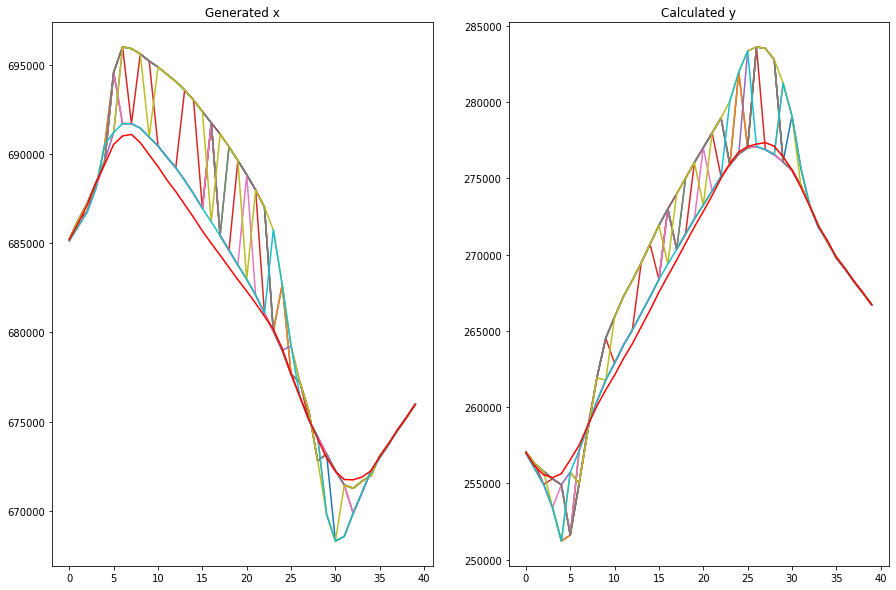

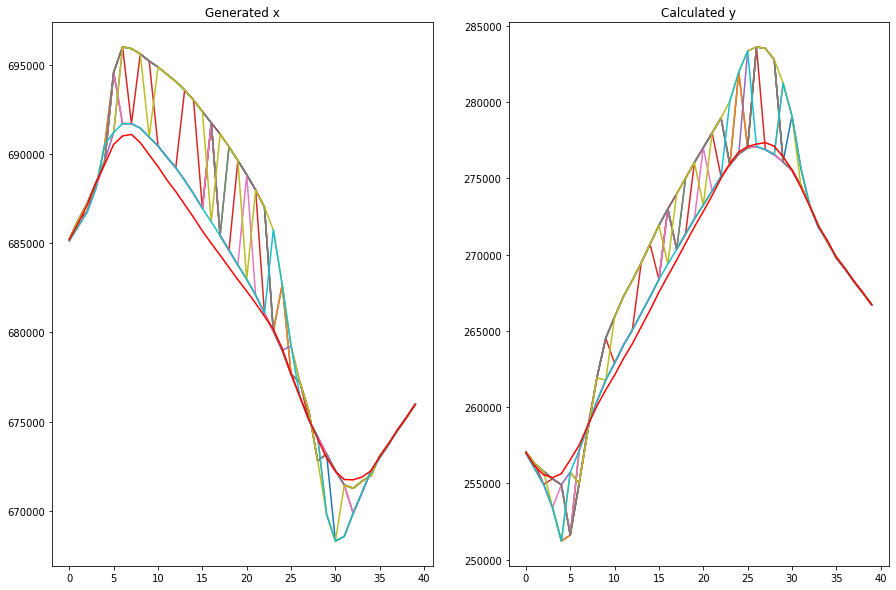

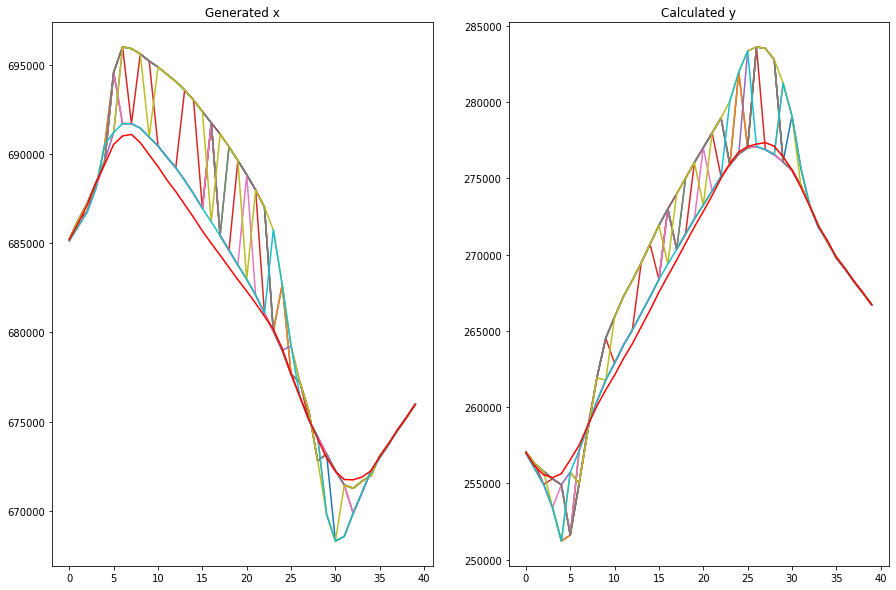

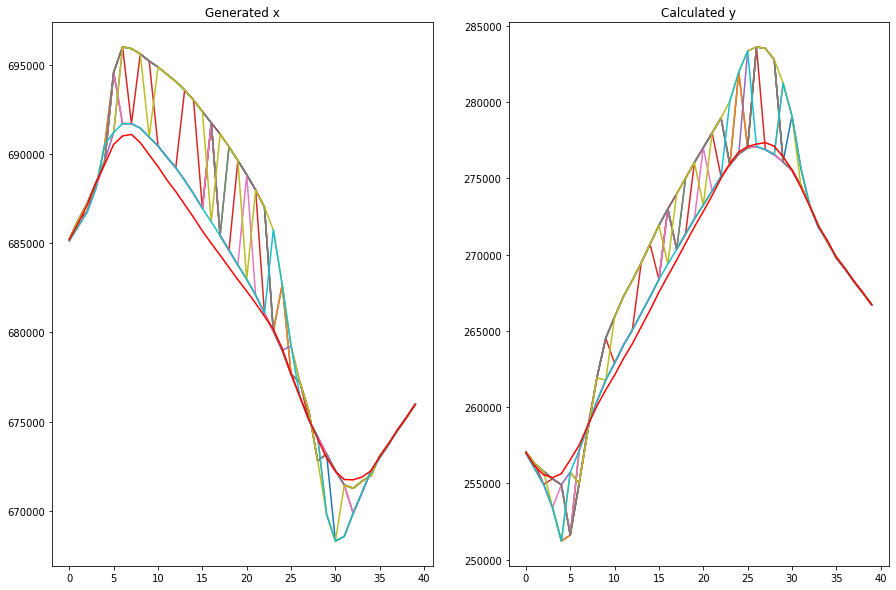

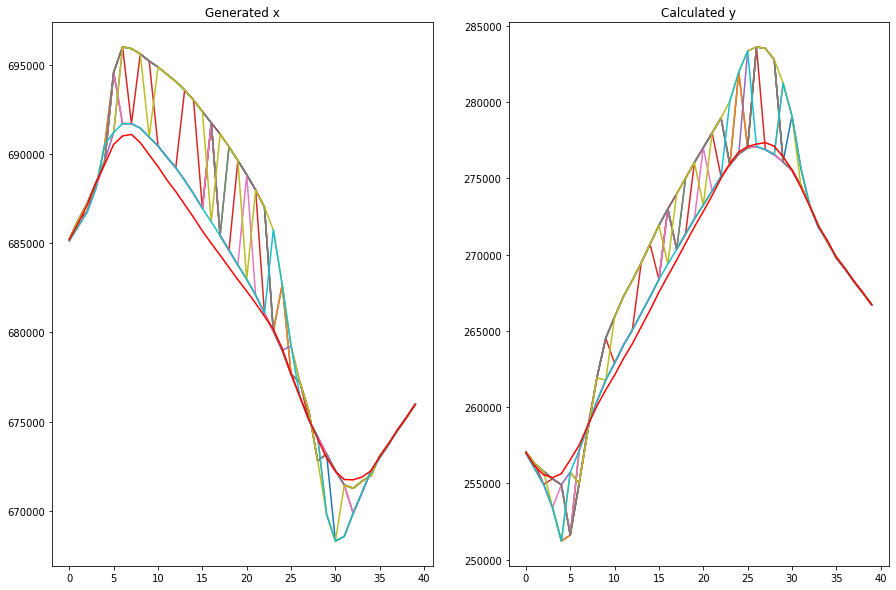

...

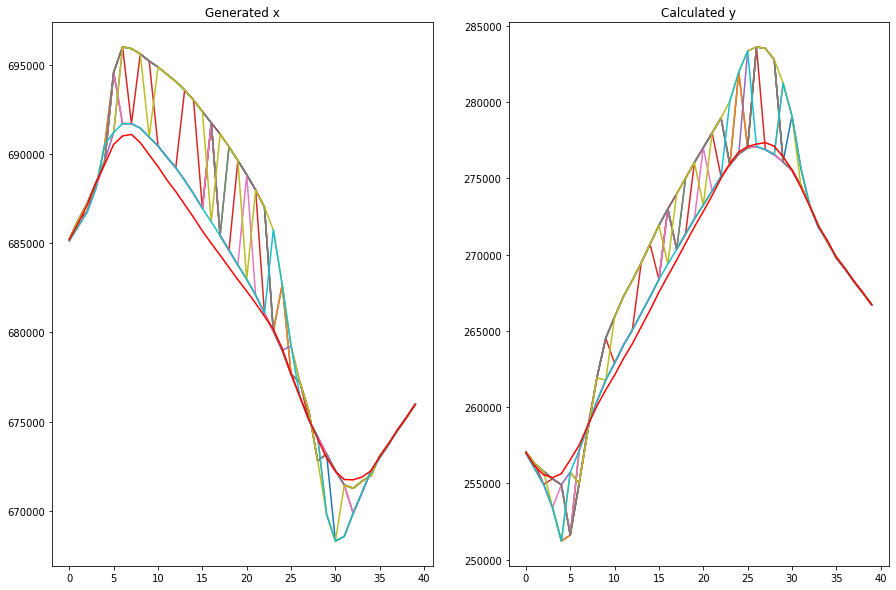

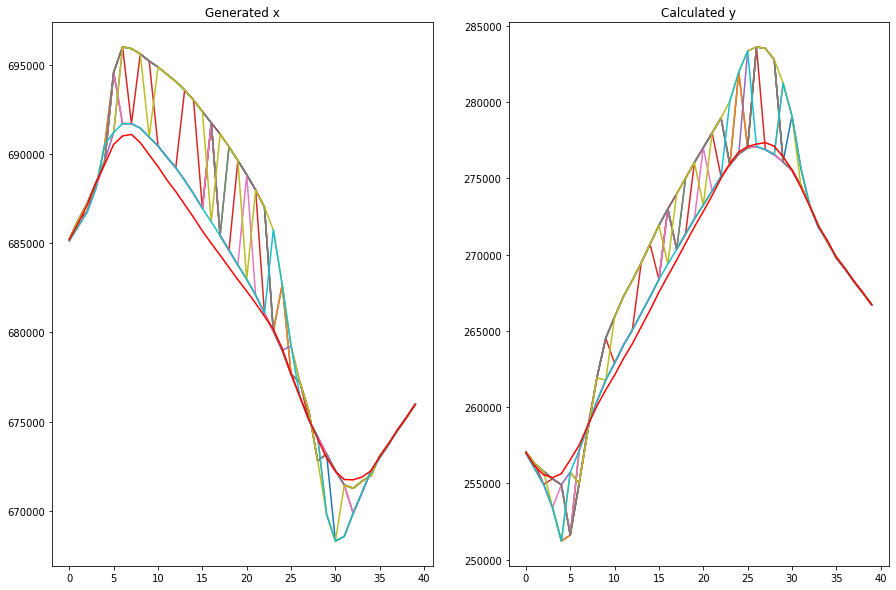

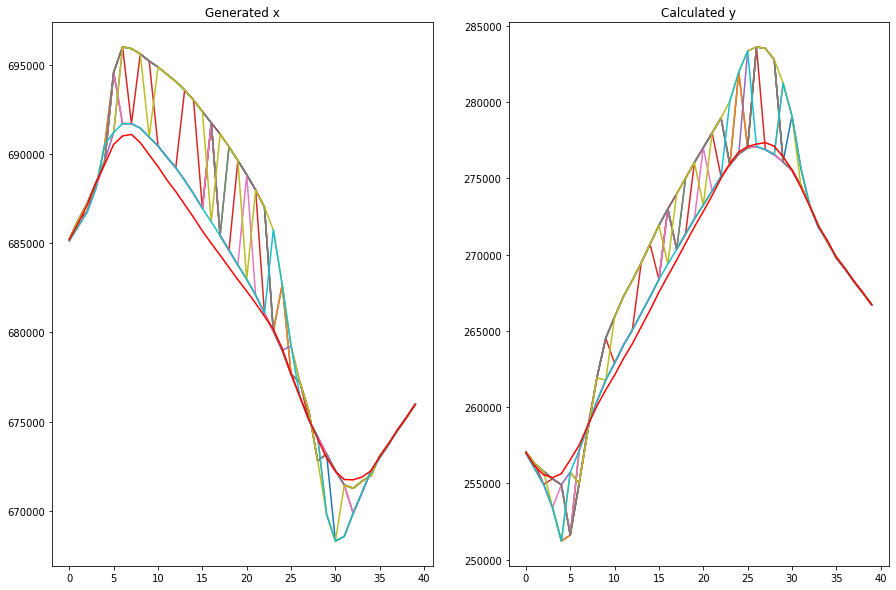

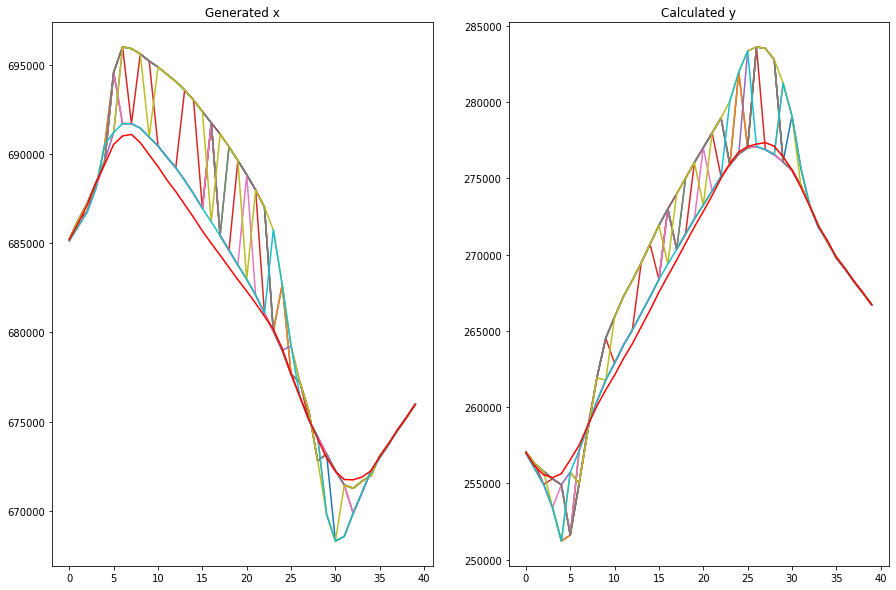

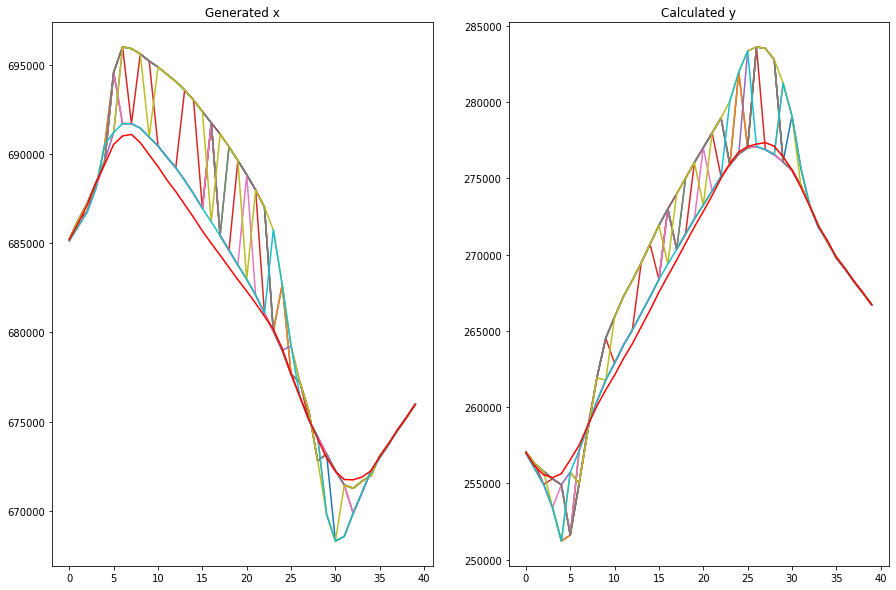

<IPython.core.display.Javascript object>

In [91]:
from IPython import display

d_error_list = []
g_error_list = []
d_pred_real_list = []
d_pred_fake_list = []

for epoch in tqdm(range(num_epochs)):
    for n_batch, real_batch in enumerate(data_loader):

        # 1. Train Discriminator
        real_data = Variable(real_batch).type(torch.FloatTensor)
        if torch.cuda.is_available():
            real_data = real_data.cuda()
        # Generate fake data
        fake_data = generator(noise(real_data.size(0))).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = train_discriminator(
            d_optimizer, real_data, fake_data
        )

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(real_batch.size(0)))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)

        d_error_list.append(d_error.data.cpu().numpy())
        g_error_list.append(g_error.data.cpu().numpy())
        d_pred_real_list.append(d_pred_real)
        d_pred_fake_list.append(d_pred_fake)

        # Display Progress
        if (n_batch) == 16:

            print("Epoch : ", epoch)
            print("n_batch : ", n_batch)
            print("d_error : ", d_error.data)
            print("g_error : ", g_error.data)
            print("")

            # Display Images
            #             display.clear_output(True)

            test_gen = scale.inverse_transform(generator(test_noise).detach().numpy())

            test_trajectories_x = test_gen * np.array(
                [np.cos(perpendiculars.angle.values),] * num_test_samples
            ) + np.array([origins[:, 0],] * num_test_samples)

            test_trajectories_y = (
                perpendiculars.m.values * test_trajectories_x + perpendiculars.p.values
            )

            # Display status Logs
            plt.figure(figsize=(15, 10))

            plt.subplot(121)
            plt.plot(test_trajectories_x.T)
            plt.plot(origins[:, 0], color="r")
            plt.title("Generated x")

            plt.subplot(122)
            plt.plot(test_trajectories_y.T)
            plt.plot(origins[:, 1], color="r")
            plt.title("Calculated y")